In [1]:
%matplotlib inline
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug.augmentables.bbs import BoundingBoxesOnImage as bb_on_image
from matplotlib import pyplot as plt
import cv2
import imageio
import os

In [2]:
def get_bbox_from_file(label_file):
    labels = [f.strip() for f in open(label_file).readlines()]    
    my_bbs = []
    for label in labels:
        label_content = label.split(' ')
        label_class = label_content[0]
        label_box = np.array(label_content[1:]).astype(np.float64)
        bbox = ia.BoundingBox(x1=label_box[0], y1=label_box[1], x2=label_box[2], y2=label_box[3], label=label_class)
        my_bbs.append(bbox)
    return my_bbs

In [3]:
img_names = [i[:-4] for i in os.listdir('images') if i[-3:] == 'jpg']
for i, fname in enumerate(img_names):
    print(i, fname)

0 rabbit
1 bear
2 handy
3 2e56a51ee4071905
4 fox
5 1b352565f3352caf
6 bird
7 goat


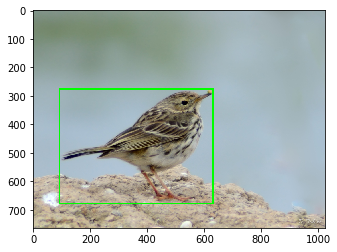

In [4]:
# select img by index
file_name = img_names[6]
label_path = os.path.join('images', file_name + '.txt')
img_path = os.path.join('images', file_name + '.jpg')
output_path = os.path.join('images', 'augmented')
bbox = get_bbox_from_file(label_path)
img = imageio.imread(img_path)
img_with_box = bb_on_image(bbox, shape=img.shape).draw_on_image(img, size=5)
plt.imshow(img_with_box)

In [11]:
# number of augmentations
n = 9

# pixel manipulation
color_augmenters = [
    iaa.Dropout(p=(0,0.1)),
    iaa.CoarseDropout((0.01,0.05), size_percent=0.1),
    iaa.Multiply((0.5,1.3), per_channel=(0.2)),
    iaa.GaussianBlur(sigma=(0,5)),
    iaa.AdditiveGaussianNoise(scale=((0, 0.2*255))),
    iaa.ContrastNormalization((0.5,1.5)),
    iaa.Grayscale(alpha=((0.1,1))),
    iaa.ElasticTransformation(alpha=(0,5.0), sigma=0.25),
    iaa.PerspectiveTransform(scale=(0.15)),
    iaa.MultiplyHueAndSaturation((0.7))
]
one_of_color = iaa.OneOf(color_augmenters)

# geometrische manipulation
# kein rotation verwenden, da boxen nur gut bei viertel drehungen sind, sonst oversized
geometric_augmenters = [
     iaa.Affine(scale=((0.6,1.2))),
     iaa.Affine(translate_percent=(-0.3,0.3)),
     iaa.Affine(shear=(-25,25)),
     iaa.Affine(translate_percent={"x": (-0.3,0.3), "y": (-0.2, 0.2)}),
     iaa.Fliplr(1),
     iaa.Affine(scale={"x": (0.6, 1.4), "y": (0.6, 1.4)})
]
two_of_geometric = iaa.SomeOf(2,geometric_augmenters)

/home/manuel/.local/lib/python3.6/site-packages/imgaug/imgaug.py:182: DeprecationWarning: Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.
  warn_deprecated(msg, stacklevel=3)


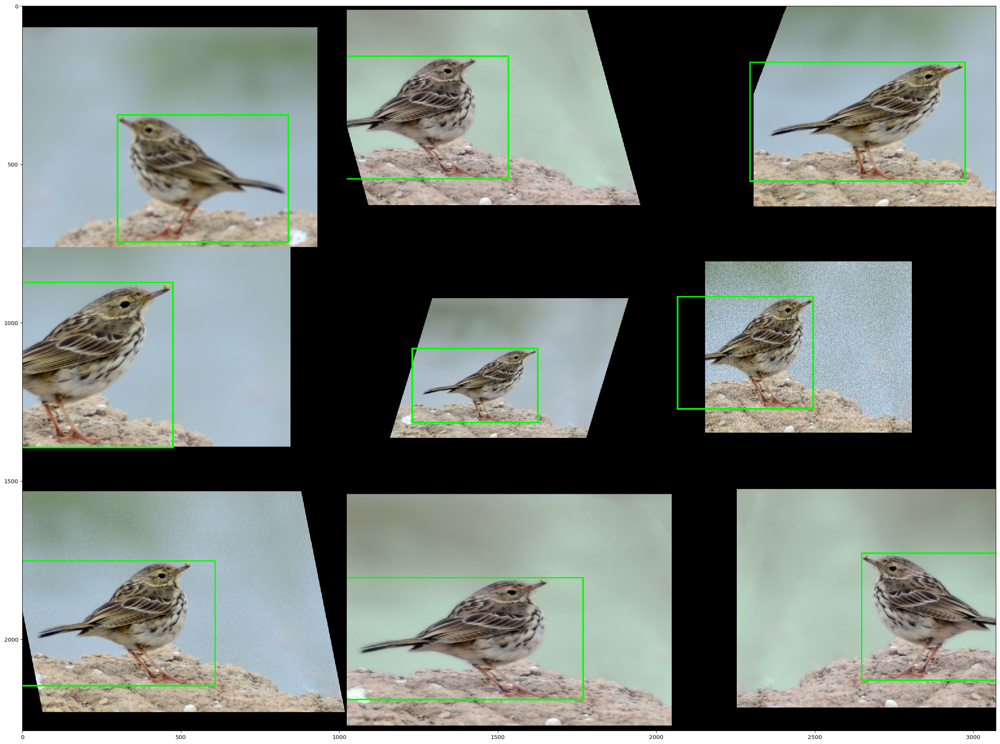

In [12]:
rows = int(np.sqrt(n))
# von beiden zufällig einen auf jedes bild anwenden
_ = one_of_color(images=(rows*rows) * [img], bounding_boxes = (rows*rows) * [bbox])
images_aug, labels_aug = two_of_geometric(images=_[0], bounding_boxes=_[1])

# boxen auf bilder zeichnen
img_aug_with_box = []
for i in range(len(images_aug)):
    img_aug_with_box.append(bb_on_image(labels_aug[i], shape=images_aug[i].shape).draw_on_image(images_aug[i], size=5))
  

stacked = np.hstack(np.array(img_aug_with_box[0:rows]))
for i in range(rows, (rows*rows), rows):
    stacked = np.vstack((stacked, np.hstack(np.array(img_aug_with_box[i:i+rows]))))
ia.imshow(stacked)

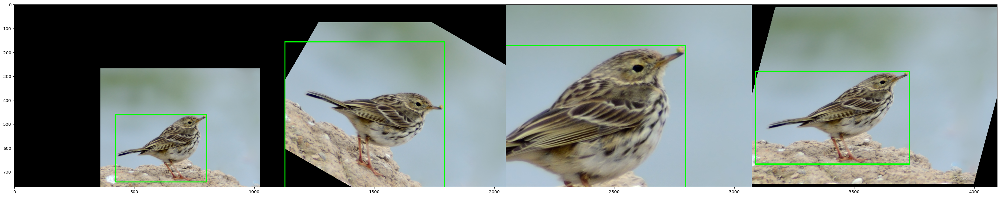

In [13]:
# Affine Augmenters

augmenters = [
    [iaa.Affine(scale=(0.7)), iaa.Affine(translate_percent=(0.2))], # zufällig zwischne +/- 30% in x/y richtung verschieben
    [iaa.Affine(rotate=(30)), iaa.Affine(translate_percent=(0.1))], # zufällig um +/- 30grad rotieren
    [iaa.Affine(scale=(2))], # zwischne 0.5fach und 2 fach zoomen
    [iaa.Affine(shear=15)] # 
]

img_aug_with_box = []

for i, augmenter in enumerate(augmenters):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_aug_with_box)

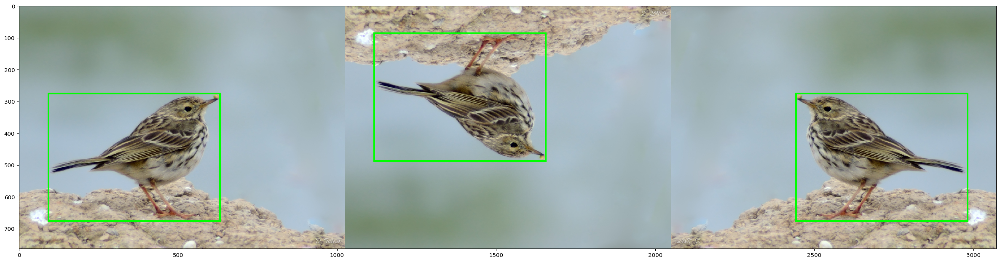

In [14]:
# flips 

augmenters = [
    [iaa.Flipud(1)], # vertical flip
    [iaa.Fliplr(1)], # horizontal flip
]

img_aug_with_box = []

for i, augmenter in enumerate(augmenters):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)

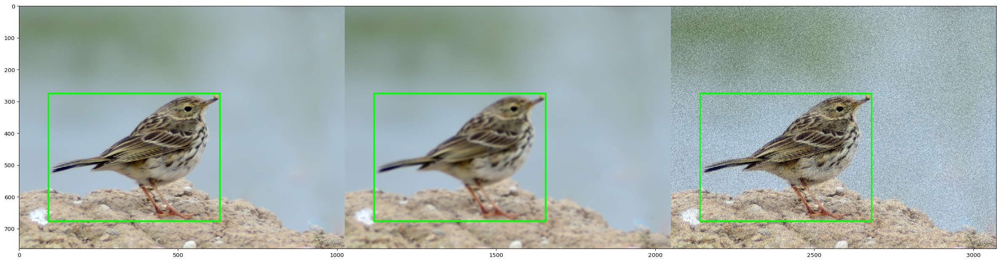

In [15]:
# Blur/Noise

aug = [
    iaa.GaussianBlur(sigma=(0,5)),
    iaa.AdditiveGaussianNoise(scale=((0.03*255, 0.3*255))), 
]
blur_noise = [[a] for a in aug]


img_aug_with_box = []

for i, augmenter in enumerate(blur_noise):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)

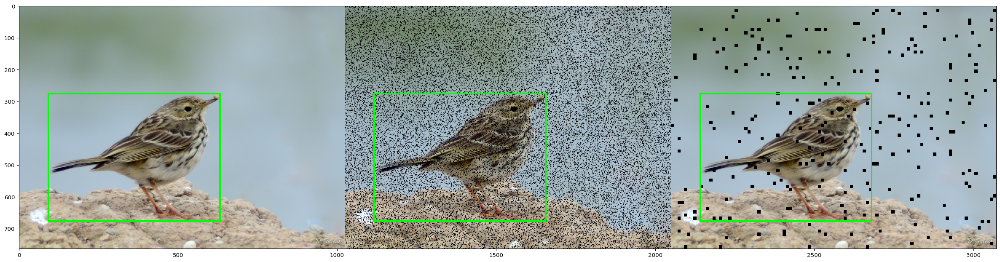

In [16]:
# Dropout
aug = [
    iaa.Dropout(p=(0.2)),
    iaa.CoarseDropout(0.03, size_percent=0.1)
]
dropout = [[a] for a in aug]

img_aug_with_box = []

for i, augmenter in enumerate(dropout):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)


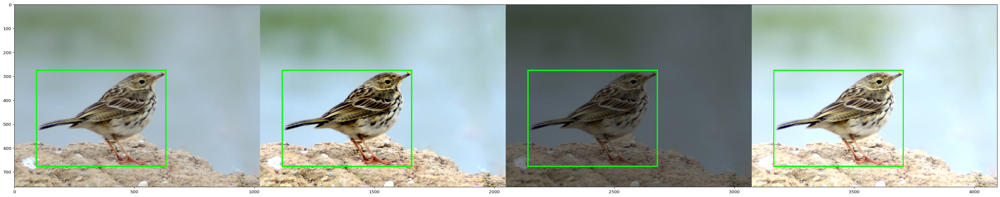

In [17]:
# Contrast
aug = [
    iaa.ContrastNormalization(1.5),
    iaa.Multiply(0.5, per_channel=(0.2)),
    iaa.Multiply(1.3, per_channel=(0.2))
]
cont_mult = [[a] for a in aug]

img_aug_with_box = []

for i, augmenter in enumerate(cont_mult):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)

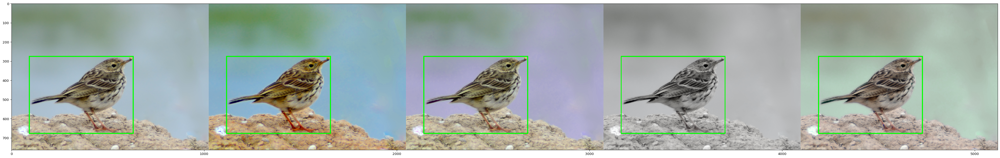

In [18]:
# Farbton und Sättigung
aug = [
    iaa.MultiplySaturation((2)), # sättigung
    iaa.MultiplyHue((1.2)), # farbton
    iaa.Grayscale(alpha=((0,1))),
    iaa.MultiplyHueAndSaturation((0.7))
]

gray = [[a] for a in aug]

img_aug_with_box = []

for i, augmenter in enumerate(gray):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)


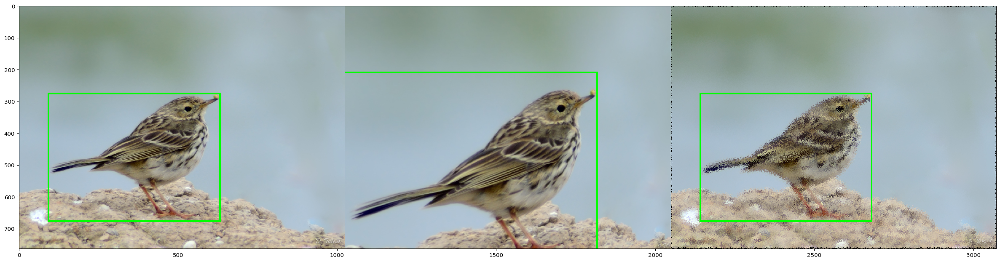

In [19]:
# Transormations
aug = [  
    iaa.PerspectiveTransform(scale=(0.15)),
    iaa.ElasticTransformation(alpha=(5.0), sigma=0.25)

]

gray = [[a] for a in aug]

img_aug_with_box = []

for i, augmenter in enumerate(gray):
    seq = iaa.Sequential(augmenter)
    img_aug, bbox_aug = seq(images=[img], bounding_boxes=[bbox])
    img_aug_with_box.append(bb_on_image(bbox_aug[0], shape=img_aug[0].shape).draw_on_image(img_aug[0], size=5))
    

img_aug_with_box = np.array(img_aug_with_box)
img_aug_with_box = np.hstack(img_aug_with_box)
img_all_with_box = np.hstack((img_with_box, img_aug_with_box))
ia.imshow(img_all_with_box)